In [2]:
import os
import glob
import matplotlib.pyplot as plt
import numpy as np
import math
from dateutil import relativedelta
from datetime import datetime
#from UAVSAR_InSAR_proc import coherence_2SLCs, phase_2SLCs
%run UAVSAR_InSAR_proc.ipynb

Processing site: NISARA
Acquisition dates: 
['190606', '190620', '190701', '190725', '190812', '190923', '190930']


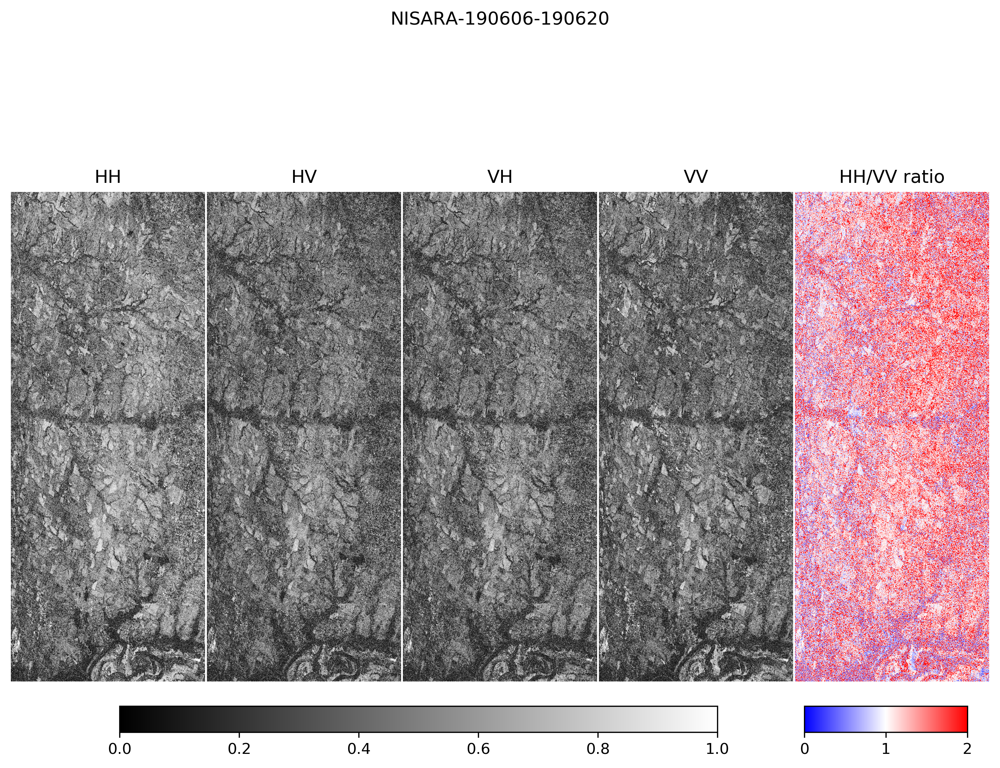

In [3]:
# coherence map and different polarimetric coherence ratio

site_list = ('NISARA_06800_seg1','winnip_31606_seg1','SanAnd_05508_seg1','SDelta_23518_seg1','winnip_31606_seg2')

SLC_data_dir = '/Users/hliao/Documents/UAF_work/coherence/npy_new_data'
output_dir = '/Users/hliao/Documents/UAF_work/coherence/npy_new_data_results/coherene_analysis'
output_dir1 = '/Users/hliao/Documents/UAF_work/coherence/npy_new_data_results/polInSAR_phase_diff'

polarizations = ['HH','HV','VH','VV']

site_temporal_coverage = {site_list[0]:('190606','190930'), site_list[1]:('120617','120717'),
                          site_list[2]:('090908','120924'), site_list[3]:('090908','120924')}

# process data 'SanAnd_05508','SDelta_23518'
# calculate every possible combination for coherence maps ...
# locate the coherence map approximately according to master/slave acquisition dates

for site in site_list:
    
    print('Processing site: ' + site.split("_")[0] + '\n' + 'Acquisition dates: ')
    
    index = site_list.index(site)
    
    # acquisitions' date list for UAVSAR site: site
    temp = [fileName.split('/')[7].split('_')[1]
            for fileName in glob.glob(os.path.join(SLC_data_dir,site.split('_')[0]+'*.npy'))]
    acq_dates = sorted(temp)
    
    # selected UAVSAR acquisitions coverage from date1 to date2
    date1 = datetime.strptime(site_temporal_coverage[site][0],'%y%m%d')
    date2 = datetime.strptime(site_temporal_coverage[site][-1],'%y%m%d')
    
    # convert date str to decimal number
    acq_dates_dec_Num = [ datetime.timestamp(datetime.strptime(date_temp,'%y%m%d')) for date_temp in acq_dates]
    
    # calculate coherence map year by year
    date_start = datetime.timestamp(date1)
    date_end = datetime.timestamp(date2)
    acq_dates_selected = [datetime.fromtimestamp(x).strftime('%y%m%d') for x in acq_dates_dec_Num if date_start <= x <= date_end]
    print(acq_dates_selected)
    
    for jj in range(len(acq_dates_selected)):
        for kk in range(jj+1,len(acq_dates_selected)):
            #print('Processing data: ' + acq_dates_selected[jj] + '-' + acq_dates_selected[kk])
            cc = []
            for count,pol in enumerate(polarizations):                        
                # subplot location: axes[row_index][col_index]                
                slc1 = np.load(os.path.join(SLC_data_dir, site.split('_')[0] + '_' + acq_dates_selected[jj] + 
                            '_rg6_azi16_ML_SLC.npy'))
                slc2 = np.load(os.path.join(SLC_data_dir, site.split('_')[0] + '_' + acq_dates_selected[kk] + 
                            '_rg6_azi16_ML_SLC.npy'))
                cc.append( coherence_2SLCs(slc1[:,:,count],slc2[:,:,count]) )
            
            # Coherence map for different polarimetric channel. HH/VV coherence ratio
            fig,axes = plt.subplots(nrows=1,ncols=5,dpi=300,figsize=(10,8))
            for count,pol in enumerate(polarizations):
                img = axes[count].imshow(cc[count],vmin=0,vmax=1,cmap='gray')
                axes[count].set_title(pol)
                axes[count].axis('off')
            cax = fig.add_axes([0.15, 0.15, 0.55, 0.03])
            fig.colorbar(img, cax=cax, orientation='horizontal',fraction=0.015, pad=0.002)
            ratio_HH_VV = cc[0]/cc[-1]
            img = axes[-1].imshow(ratio_HH_VV,vmin=0,vmax=2,cmap='bwr')
            axes[-1].set_title('HH/VV ratio')
            axes[-1].axis('off')
            cax = fig.add_axes([0.78, 0.15, 0.15, 0.03])
            fig.colorbar(img, cax=cax, orientation='horizontal',fraction=0.015,pad=0.002)
            fig.suptitle(site.split('_')[0] + '-' + acq_dates_selected[jj] + '-' + acq_dates_selected[kk])
            fig.subplots_adjust(left=0.05, bottom=0.08, right=0.95, top=0.9, wspace=0.01, hspace=0.01)
                
            outfile = os.path.join(output_dir, site.split("_")[0] + '-' + acq_dates_selected[jj] + '-' + acq_dates_selected[kk])
            fig.savefig(outfile,dpi=300)
            
            if (jj !=0 or kk != jj+1):
                plt.close(fig)
            
            

Processing site: NISARA
Acquisition dates: 
['190606', '190620', '190701', '190725', '190812', '190923', '190930']
Processing site: winnip
Acquisition dates: 
['120617', '120619', '120622', '120623', '120625', '120627', '120629', '120703', '120705', '120708', '120710', '120713', '120714', '120717']
Processing site: SanAnd
Acquisition dates: 
['090908', '091002', '091102', '091117', '091203', '100114', '100115', '100409', '100510', '100511', '100617', '100712', '100810', '100925', '101025', '101110', '101201', '110110', '110330', '110512', '110616', '110712', '110720', '110829', '111003', '111102', '111207', '120105', '120213', '120322', '120424', '120530', '120718', '120815', '120924']
Processing site: SDelta
Acquisition dates: 
['090908', '091002', '091102', '091203', '100114', '100303', '100409', '100510', '100617', '100712', '100810', '100925', '101025', '101130', '110110', '110330', '110512', '110616', '110720', '110829', '111003', '111102', '111207', '120105', '120213', '120322', 

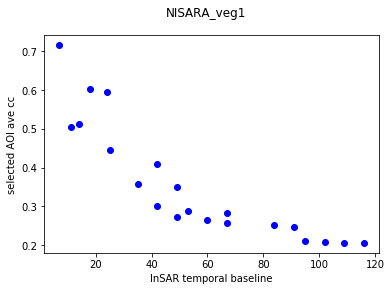

In [34]:
# coherence vs temporal baseline

site_list = ('NISARA_06800','winnip_31606','SanAnd_05508','SDelta_23518')

SLC_data_dir = '/Users/hliao/Documents/UAF_work/coherence/npy_new_data'
output_dir = '/Users/hliao/Documents/UAF_work/coherence/npy_new_data_results/coherene_analysis'
mask_dir = '/Users/hliao/Documents/UAF_work/coherence/AOI_mask_data'

polarizations = ['HH','HV','VH','VV']

site_temporal_coverage = {site_list[0]:('190606','190930'), site_list[1]:('120617','120717'),
                          site_list[2]:('090908','120924'), site_list[3]:('090908','120924')}

sites_land_type = {'NISARA':['NISARA_veg1','NISARA_veg2','NISARA_veg3','NISARA_veg4','NISARA_veg5',
                            'NISARA_veg6','NISARA_veg7','NISARA_veg8','NISARA_veg9','NISARA_veg10',],
                   'SDelta':['SDelta_agr1','SDelta_agr2','SDelta_agr3','SDelta_agr4','SDelta_agr5',
                            'SDelta_agr6','SDelta_agr7','SDelta_agr8','SDelta_agr9','SDelta_agr10',], 
                   'winnip':['winnip_agr1','winnip_agr2','winnip_agr3','winnip_agr4','winnip_agr5',
                            'winnip_agr6','winnip_agr7','winnip_agr8','winnip_agr9','winnip_agr10','winnip_agr11',],
                   'SanAnd':['SanAnd_bareland1','SanAnd_bareland2','SanAnd_bareland3','SanAnd_bareland4','SanAnd_bareland5',
                            'SanAnd_bareland6','SanAnd_bareland7','SanAnd_bareland8','SanAnd_bareland9','SanAnd_bareland10']}

for site in site_list:
    
    print('Processing site: ' + site.split("_")[0] + '\n' + 'Acquisition dates: ')
    
    index = site_list.index(site)
    
    # acquisitions' date list for UAVSAR site: site
    temp = [fileName.split('/')[7].split('_')[1]
            for fileName in glob.glob(os.path.join(SLC_data_dir,site.split('_')[0]+'*.npy'))]
    acq_dates = sorted(temp)
    
    # selected UAVSAR acquisitions coverage from date1 to date2
    date1 = datetime.strptime(site_temporal_coverage[site][0],'%y%m%d')
    date2 = datetime.strptime(site_temporal_coverage[site][-1],'%y%m%d')
    
    # convert date str to decimal number
    acq_dates_dec_Num = [ datetime.timestamp(datetime.strptime(date_temp,'%y%m%d')) for date_temp in acq_dates]
    
    # calculate coherence map year by year
    date_start = datetime.timestamp(date1)
    date_end = datetime.timestamp(date2)
    acq_dates_selected = [datetime.fromtimestamp(x).strftime('%y%m%d') for x in acq_dates_dec_Num if date_start <= x <= date_end]
    print(acq_dates_selected)
    
    # load the land mask. only the first aoi
    mask_file = os.path.join(mask_dir, sites_land_type[site.split('_')[0]][0]  + '_' + 'polygon_mask.npy')
    land_cover_mask = np.load(mask_file)
    
    ave_aoi_cc, delta_T = [], []
    for jj in range(len(acq_dates_selected)):
        for kk in range(jj+1,len(acq_dates_selected)):
            #print('Processing data: ' + acq_dates_selected[jj] + '-' + acq_dates_selected[kk])
            time1 = datetime.strptime(acq_dates_selected[jj],'%y%m%d')
            time2 = datetime.strptime(acq_dates_selected[kk],'%y%m%d')
            delta_T.append( (time2-time1).days)
            
            slc1 = np.load(os.path.join(SLC_data_dir, site.split('_')[0] + '_' + acq_dates_selected[jj] + 
                        '_rg6_azi16_ML_SLC.npy'))
            slc2 = np.load(os.path.join(SLC_data_dir, site.split('_')[0] + '_' + acq_dates_selected[kk] + 
                        '_rg6_azi16_ML_SLC.npy'))
            cc = coherence_2SLCs(slc1[:,:,0],slc2[:,:,0])
            ave_cc = np.mean( cc[land_cover_mask] )
            ave_aoi_cc.append( ave_cc ) # only HH channel
    
    # plot the temporal separation vs average coherence
    fig,axes = plt.subplots(nrows=1,ncols=1)
    delta_T_sort = sorted(set(delta_T))
    for ii in delta_T_sort:
        index_value = (np.array(delta_T) == ii)
        delta_T_np = np.array(delta_T)
        ave_aoi_cc_np = np.array(ave_aoi_cc)
        axes.plot(delta_T_np[index_value], ave_aoi_cc_np[index_value],'bo')
    axes.set_xlabel('InSAR temporal baseline')
    axes.set_ylabel('selected AOI ave cc')
    fig.suptitle(sites_land_type[site.split('_')[0]][0])
    
    fig.savefig(os.path.join(output_dir,site.split("_")[0] + 'temporal_baseline_vs_coherence'),dpi=300)
    
    if (index !=0):
        plt.close(fig)
                
    #break
            

Processing site: NISARA
Acquisition dates: 
['190606', '190620', '190701', '190725', '190812', '190923', '190930']
Processing site: winnip
Acquisition dates: 
['120617', '120619', '120622', '120623', '120625', '120627', '120629', '120703', '120705', '120708', '120710', '120713', '120714', '120717']
Processing site: SanAnd
Acquisition dates: 
['090908', '091002', '091102', '091117', '091203', '100114', '100115', '100409', '100510', '100511', '100617', '100712', '100810', '100925', '101025', '101110', '101201', '110110', '110330', '110512', '110616', '110712', '110720', '110829', '111003', '111102', '111207', '120105', '120213', '120322', '120424', '120530', '120718', '120815', '120924']
Processing site: SDelta
Acquisition dates: 
['090908', '091002', '091102', '091203', '100114', '100303', '100409', '100510', '100617', '100712', '100810', '100925', '101025', '101130', '110110', '110330', '110512', '110616', '110720', '110829', '111003', '111102', '111207', '120105', '120213', '120322', 

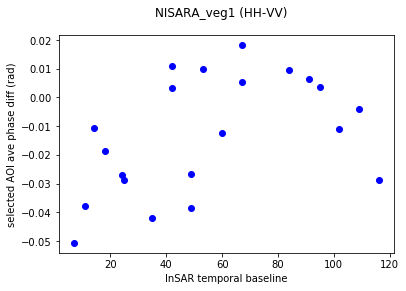

In [36]:
# phase difference vs temporal baseline

site_list = ('NISARA_06800','winnip_31606','SanAnd_05508','SDelta_23518')

SLC_data_dir = '/Users/hliao/Documents/UAF_work/coherence/npy_new_data'
output_dir = '/Users/hliao/Documents/UAF_work/coherence/npy_new_data_results/polInSAR_phase_diff'
mask_dir = '/Users/hliao/Documents/UAF_work/coherence/AOI_mask_data'

polarizations = ['HH','HV','VH','VV']

site_temporal_coverage = {site_list[0]:('190606','190930'), site_list[1]:('120617','120717'),
                          site_list[2]:('090908','120924'), site_list[3]:('090908','120924')}

sites_land_type = {'NISARA':['NISARA_veg1','NISARA_veg2','NISARA_veg3','NISARA_veg4','NISARA_veg5',
                            'NISARA_veg6','NISARA_veg7','NISARA_veg8','NISARA_veg9','NISARA_veg10',],
                   'SDelta':['SDelta_agr1','SDelta_agr2','SDelta_agr3','SDelta_agr4','SDelta_agr5',
                            'SDelta_agr6','SDelta_agr7','SDelta_agr8','SDelta_agr9','SDelta_agr10',], 
                   'winnip':['winnip_agr1','winnip_agr2','winnip_agr3','winnip_agr4','winnip_agr5',
                            'winnip_agr6','winnip_agr7','winnip_agr8','winnip_agr9','winnip_agr10','winnip_agr11',],
                   'SanAnd':['SanAnd_bareland1','SanAnd_bareland2','SanAnd_bareland3','SanAnd_bareland4','SanAnd_bareland5',
                            'SanAnd_bareland6','SanAnd_bareland7','SanAnd_bareland8','SanAnd_bareland9','SanAnd_bareland10']}

for site in site_list:
    
    print('Processing site: ' + site.split("_")[0] + '\n' + 'Acquisition dates: ')
    
    index = site_list.index(site)
    
    # acquisitions' date list for UAVSAR site: site
    temp = [fileName.split('/')[7].split('_')[1]
            for fileName in glob.glob(os.path.join(SLC_data_dir,site.split('_')[0]+'*.npy'))]
    acq_dates = sorted(temp)
    
    # selected UAVSAR acquisitions coverage from date1 to date2
    date1 = datetime.strptime(site_temporal_coverage[site][0],'%y%m%d')
    date2 = datetime.strptime(site_temporal_coverage[site][-1],'%y%m%d')
    
    # convert date str to decimal number
    acq_dates_dec_Num = [ datetime.timestamp(datetime.strptime(date_temp,'%y%m%d')) for date_temp in acq_dates]
    
    # calculate coherence map year by year
    date_start = datetime.timestamp(date1)
    date_end = datetime.timestamp(date2)
    acq_dates_selected = [datetime.fromtimestamp(x).strftime('%y%m%d') for x in acq_dates_dec_Num if date_start <= x <= date_end]
    print(acq_dates_selected)
    
    # load the land mask. only the first aoi
    mask_file = os.path.join(mask_dir, sites_land_type[site.split('_')[0]][0]  + '_' + 'polygon_mask.npy')
    land_cover_mask = np.load(mask_file)
    
    delta_T, ave_phase_diff = [], []
    for jj in range(len(acq_dates_selected)):
        for kk in range(jj+1,len(acq_dates_selected)):
            #print('Processing data: ' + acq_dates_selected[jj] + '-' + acq_dates_selected[kk])
            time1 = datetime.strptime(acq_dates_selected[jj],'%y%m%d')
            time2 = datetime.strptime(acq_dates_selected[kk],'%y%m%d')
            delta_T.append( (time2-time1).days)
            
            slc1 = np.load(os.path.join(SLC_data_dir, site.split('_')[0] + '_' + acq_dates_selected[jj] + 
                        '_rg6_azi16_ML_SLC.npy'))
            slc2 = np.load(os.path.join(SLC_data_dir, site.split('_')[0] + '_' + acq_dates_selected[kk] + 
                        '_rg6_azi16_ML_SLC.npy'))
            
            InSAR_pol_diff = [(0,-1),(0,1),(1,2),(2,-1)] # HH-VV, HH-HV, HV-VH, VH-VV
            # calculate phase difference between different channel, only HH-VV
            cpx_intf1 = slc1[:,:,InSAR_pol_diff[0][0]]*np.conj(slc2[:,:,InSAR_pol_diff[0][0]])
            cpx_intf2 = slc1[:,:,InSAR_pol_diff[0][1]]*np.conj(slc2[:,:,InSAR_pol_diff[0][1]])
                
            phase_diff = phase_2SLCs( cpx_intf1, cpx_intf2)                
            temp = np.mean( phase_diff[land_cover_mask] )
            
            ave_phase_diff.append( temp ) # only HH channel
    
    # plot the temporal separation vs average phase difference
    fig,axes = plt.subplots(nrows=1,ncols=1)
    delta_T_sort = sorted(set(delta_T))
    for ii in delta_T_sort:
        index_value = (np.array(delta_T) == ii)
        delta_T_np = np.array(delta_T)
        ave_phase_diff_np = np.array(ave_phase_diff)
        axes.plot(delta_T_np[index_value], ave_phase_diff_np[index_value],'bo')
    axes.set_xlabel('InSAR temporal baseline')
    axes.set_ylabel('selected AOI ave phase diff (rad)')
    fig.suptitle(sites_land_type[site.split('_')[0]][0] + ' (HH-VV)')
    
    fig.savefig(os.path.join(output_dir,site.split("_")[0] + 'temporal_baseline_vs_phase_diff'),dpi=300)
    
    if (index !=0):
        plt.close(fig)
                

Processing site: NISARA
Acquisition dates: 
['190606', '190620', '190701', '190725', '190812', '190923', '190930']
Processing data: 190606-190620
Processing site: winnip
Acquisition dates: 
['120617', '120619', '120622', '120623', '120625', '120627', '120629', '120703', '120705', '120708', '120710', '120713', '120714', '120717']
Processing data: 120617-120619
Processing site: SanAnd
Acquisition dates: 
['090908', '091002', '091102', '091117', '091203', '100114', '100115', '100409', '100510', '100511', '100617', '100712', '100810', '100925', '101025', '101110', '101201', '110110', '110330', '110512', '110616', '110712', '110720', '110829', '111003', '111102', '111207', '120105', '120213', '120322', '120424', '120530', '120718', '120815', '120924']
Processing data: 090908-091002
Processing site: SDelta
Acquisition dates: 
['090908', '091002', '091102', '091203', '100114', '100303', '100409', '100510', '100617', '100712', '100810', '100925', '101025', '101130', '110110', '110330', '110512

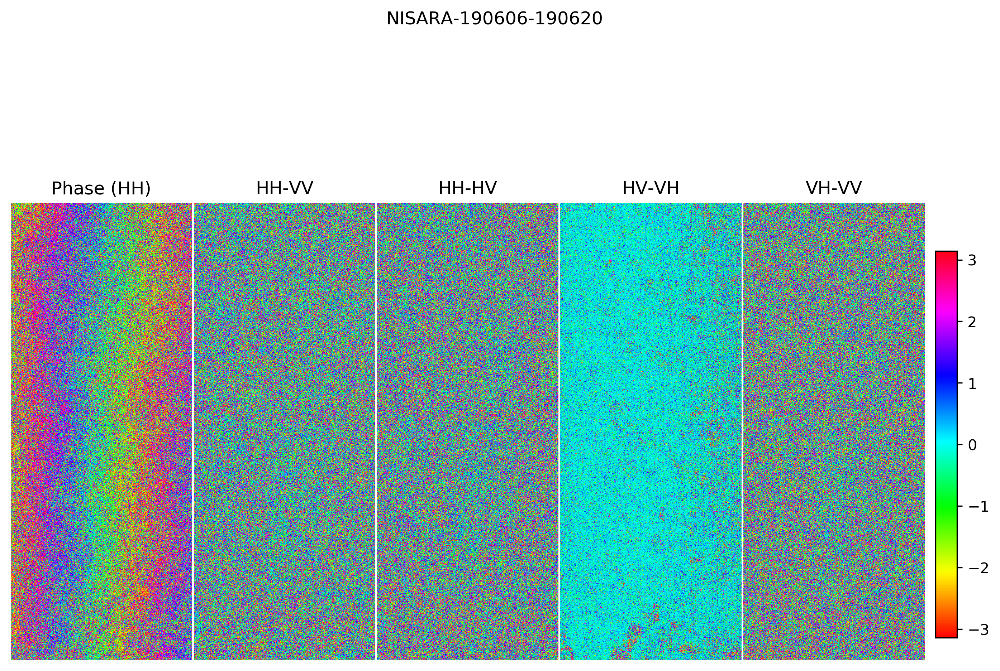

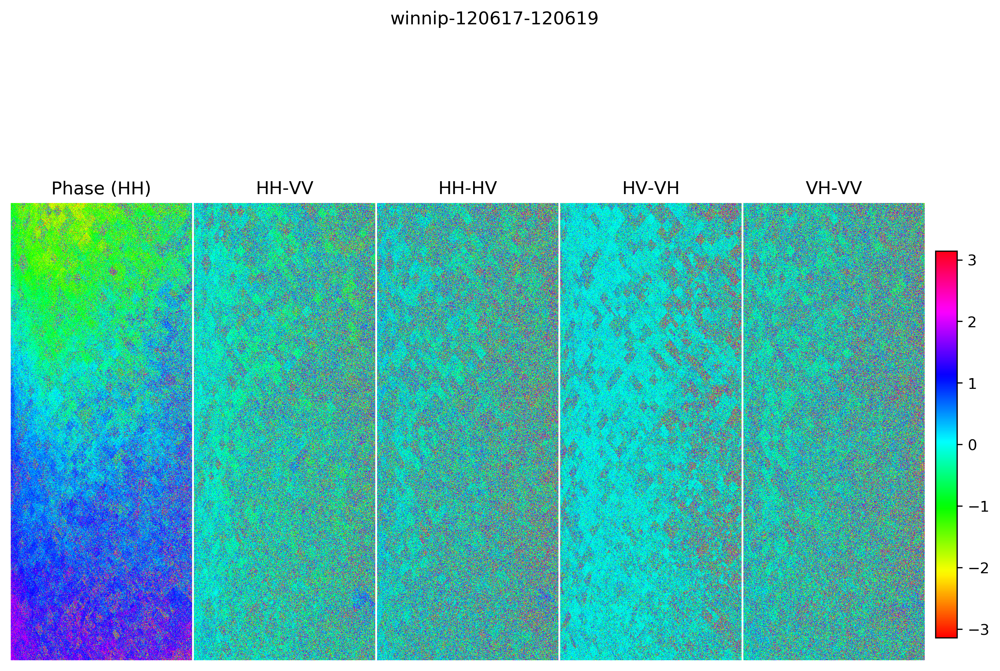

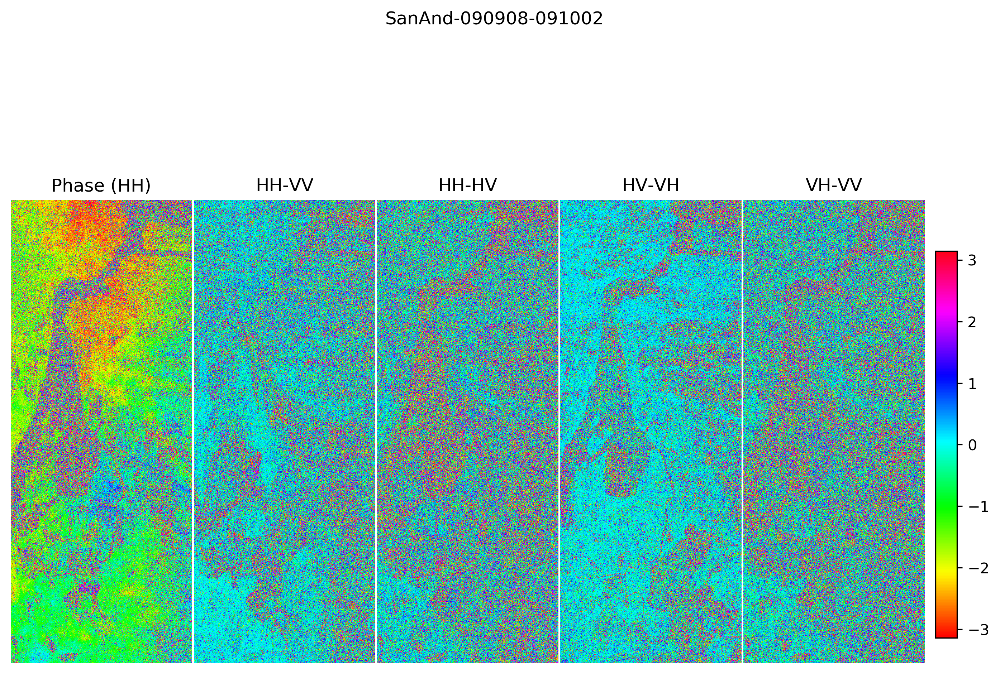

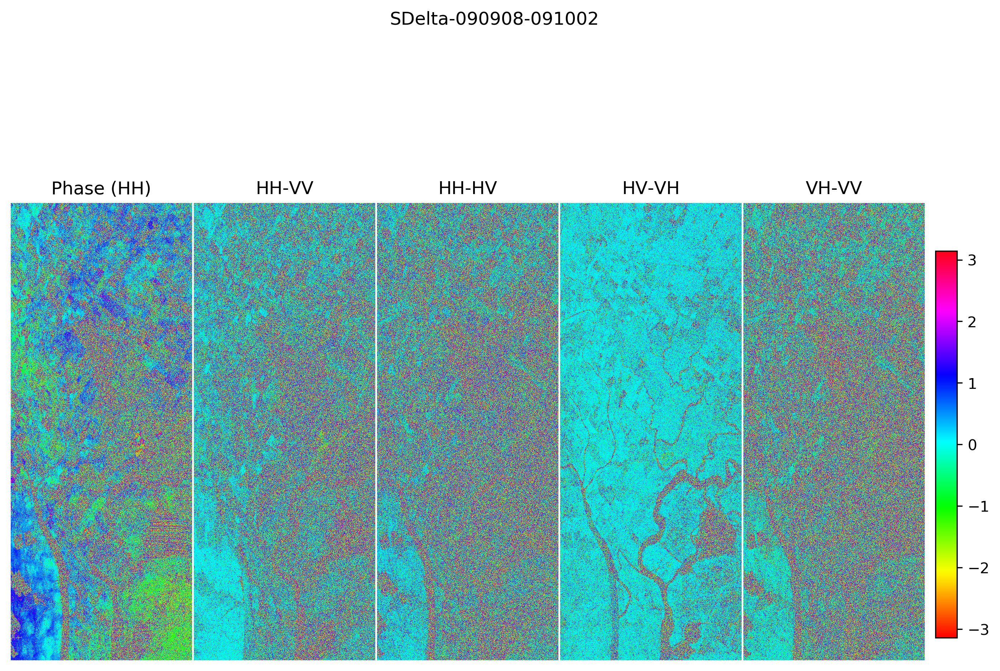

In [11]:
# different channel InSAR phase difference

for site in site_list:
    
    print('Processing site: ' + site.split("_")[0] + '\n' + 'Acquisition dates: ')
    
    index = site_list.index(site)
    
    # acquisitions' date list for UAVSAR site: site
    temp = [fileName.split('/')[7].split('_')[1]
            for fileName in glob.glob(os.path.join(SLC_data_dir,site.split('_')[0]+'*.npy'))]
    acq_dates = sorted(temp)
    
    # selected UAVSAR acquisitions coverage from date1 to date2
    date1 = datetime.strptime(site_temporal_coverage[site][0],'%y%m%d')
    date2 = datetime.strptime(site_temporal_coverage[site][-1],'%y%m%d')
    
    # convert date str to decimal number
    acq_dates_dec_Num = [ datetime.timestamp(datetime.strptime(date_temp,'%y%m%d')) for date_temp in acq_dates]
    
    # calculate coherence map year by year
    date_start = datetime.timestamp(date1)
    date_end = datetime.timestamp(date2)
    acq_dates_selected = [datetime.fromtimestamp(x).strftime('%y%m%d') for x in acq_dates_dec_Num if date_start <= x <= date_end]
    print(acq_dates_selected)
    
    for jj in range(len(acq_dates_selected)):
        for kk in range(jj+1,len(acq_dates_selected)):
            print('Processing data: ' + acq_dates_selected[jj] + '-' + acq_dates_selected[kk])
            slc1 = np.load(os.path.join(SLC_data_dir, site.split('_')[0] + '_' + acq_dates_selected[jj] + 
                        '_rg6_azi16_ML_SLC.npy'))
            slc2 = np.load(os.path.join(SLC_data_dir, site.split('_')[0] + '_' + acq_dates_selected[kk] + 
                        '_rg6_azi16_ML_SLC.npy'))
            
            phase, phase_diff, cc = [], [], []
            
            InSAR_pol_diff = [(0,-1),(0,1),(1,2),(2,-1)] # HH-VV, HH-HV, HV-VH, VH-VV
            # calculate the phase difference of difference channels for selected land-cover
            for mm in range(len(InSAR_pol_diff)):
                # calculate InSAR phase and coherence of each channel.
                phase.append( phase_2SLCs(slc1[:,:,count],slc2[:,:,count]) )
                cc.append( coherence_2SLCs(slc1[:,:,count],slc2[:,:,count]) )
                
                # calculate phase difference between different channel
                cpx_intf1 = slc1[:,:,InSAR_pol_diff[mm][0]]*np.conj(slc2[:,:,InSAR_pol_diff[mm][0]])
                cpx_intf2 = slc1[:,:,InSAR_pol_diff[mm][1]]*np.conj(slc2[:,:,InSAR_pol_diff[mm][1]])
                phase_diff.append( phase_2SLCs( cpx_intf1, cpx_intf2) )
                
            # HH InSAR phase and Phase differences between different polarimetric channels
            fig,axes = plt.subplots(nrows=1,ncols=5,dpi=300,figsize=(10,8))
            img = axes[0].imshow(phase[0],cmap='hsv',vmin = -np.pi, vmax = np.pi)
            axes[0].set_title('Phase (HH)')
            axes[0].axis('off')
            for count,phase_diff_val in enumerate(phase_diff):
                img = axes[count+1].imshow(phase_diff[count],vmin=-np.pi,vmax=np.pi,cmap='hsv')
                axes[count+1].set_title(polarizations[InSAR_pol_diff[count][0]] + '-' + polarizations[InSAR_pol_diff[count][1]])
                axes[count+1].axis('off')
            cax = fig.add_axes([0.91, 0.25, 0.02, 0.45])
            fig.colorbar(img, cax=cax, orientation='vertical',fraction=0.015,pad=0.002)
            fig.suptitle(site.split('_')[0] + '-' + acq_dates_selected[jj] + '-' + acq_dates_selected[kk])
            fig.subplots_adjust(left=0.05, bottom=0.08, right=0.90, top=0.9, wspace=0.01, hspace=0.01)
                
            outfile = os.path.join(output_dir1, site.split("_")[0] + '-' + acq_dates_selected[jj] + '-' + acq_dates_selected[kk] + '-diff-phase')
            fig.savefig(outfile,dpi=300)
            
            if (jj !=0 or kk != jj+1):
                plt.close(fig)
            
            #break
        #break
                
            

In [11]:
f1 = (1215 + 10)*10**6
f2 = (1215 + 82.5)*10**6
f0 = (1215+42.5)*10**6
const = f1*f2*f2/(f2*f2-f1*f1)/f0
print(f1,f2,const)

11.7/2/3.141

1225000000 1297500000.0 8.967546690058889


1.8624641833810887